### Laboratorium 6 - część badawcza

W pakiecie OpenCV wszystkie zadania związane z detekcją i opisem punktów kluczowych realizowane są przez zestaw specjalnych klas, dla których bazową jest `cv::Feature2D`. Jedną z wielu pochodnych tej klasy jest interesująca nas na zajęciach `cv::SIFT`, z której dokumentacją należy się zapoznać.  
Najważniejsze, co trzeba wiedzieć:
1. do konstrukcji obiektu SIFT służy metoda [`cv2.SIFT_create`](https://docs.opencv.org/4.x/d7/d60/classcv_1_1SIFT.html#ad337517bfdc068ae0ba0924ff1661131) - to do niej przekazujemy parametry detektora (w dokumentacji występuje jako `cv::SIFT::create`);
2. obsługujemy detektor przez interfejs `cv::Feature2D`, konkretnie metody [`detect`](https://docs.opencv.org/4.x/d0/d13/classcv_1_1Feature2D.html#aa4e9a7082ec61ebc108806704fbd7887) do detekcji punktów kluczowych oraz [`compute`](https://docs.opencv.org/4.x/d0/d13/classcv_1_1Feature2D.html#ab3cce8d56f4fc5e1d530b5931e1e8dc0) do obliczania ich deskryptorów (opcjonalnie `detectAndCompute`).

Schemat użycia:
```python
sift_instance = cv2.SIFT_create()
# 'image' powinno być obrazem jednokanałowym (jeśli nie, zostanie zastosowane cvtColor z flagą COLOR_BGR2GRAY)
keypoints = sift_instance.detect(image)
keypoints, descriptors = sift_instance.compute(image, keypoints)
```

`keypoints` jest listą obiektów specjalnego typu `cv2.KeyPoint`, która **jest modyfikowana** przez `SIFT::compute`!  
`descriptors` jest natomiast macierzą float32 o wymiarach NxK, gdzie N jest liczbą punktów kluczowych, a K jest liczbą obliczonych cech.

Warto również zapoznać się z funkcją [`cv2.drawKeypoints`](https://docs.opencv.org/4.x/d4/d5d/group__features2d__draw.html#ga5d2bafe8c1c45289bc3403a40fb88920) w kontekście prezentacji wyników. Zwróć uwagę na flagi sterujące rysowaniem - szczególnie użyteczna jest `cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS`.

In [1]:
import cv2
import matplotlib.pyplot as plt
import numpy as np

#### Zadanie 1

Przetestuj wpływ podstawowych parametrów detektora SIFT (`contrastThreshold` i `edgeThreshold`) na uzyskiwane punkty kluczowe (liczność, lokalizacja, rozmiar), korzystając z obrazów `cells` i `lena`. Pamiętaj że ich działanie jest odwrotne (tzn. jeden odsiewa cechy "mniejsze niż", a drugi "większe niż").

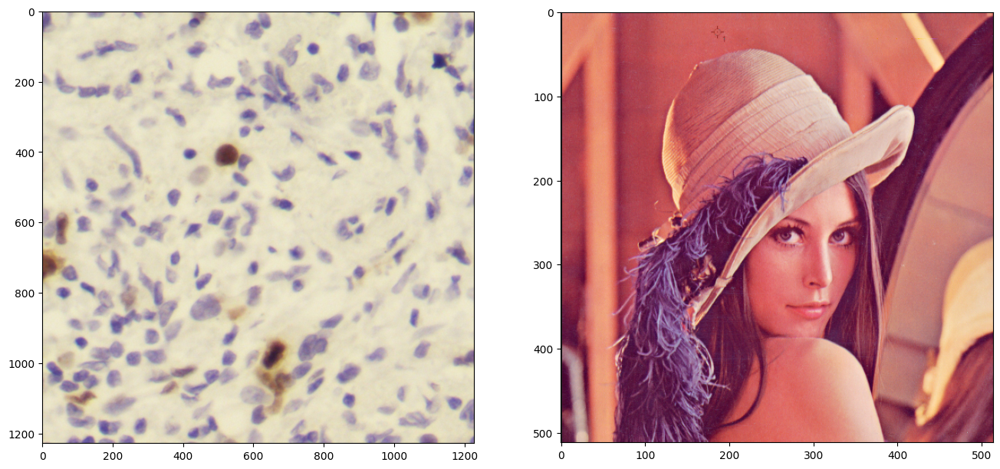

In [2]:
cells = cv2.imread('p1_0308_7.jpg')
lena = cv2.imread('Lena.jpg')
f, (a1, a2) = plt.subplots(1, 2, figsize=(16, 10))
a1.imshow(cells[..., ::-1]);
a2.imshow(lena[..., ::-1]);

Bazowo:
- contrastThreshold = 0.04
- edgeThreshold = 10

In [3]:
contrasts = [0.02, 0.05, 0.09, 0.12]
thresholds = [5, 15, 25, 50]

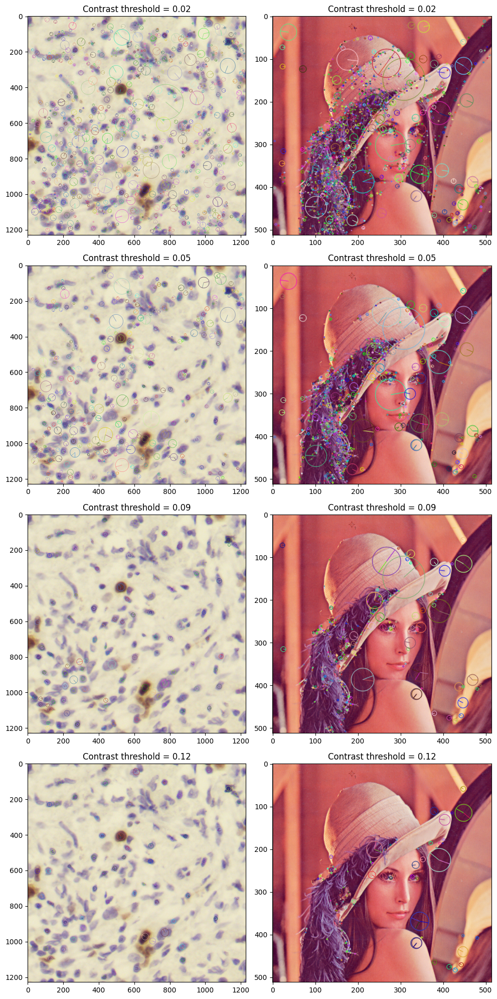

In [4]:
plt.figure(figsize=(10, 20))

for i, c in enumerate(contrasts):
    sift = cv2.SIFT_create(contrastThreshold=c)
    kp, des = sift.detectAndCompute(cells, None)
    kp2, des2 = sift.detectAndCompute(lena, None)
    
    d_cells = cv2.drawKeypoints(cells, kp, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
    d_lena = cv2.drawKeypoints(lena, kp2, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
    
    plt.subplot(4, 2, 2*i+1)
    plt.imshow(d_cells[..., ::-1])
    plt.title(f'Contrast threshold = {c}')

    plt.subplot(4, 2, 2*i+2)
    plt.imshow(d_lena[..., ::-1])
    plt.title(f'Contrast threshold = {c}')

plt.tight_layout()
plt.show()

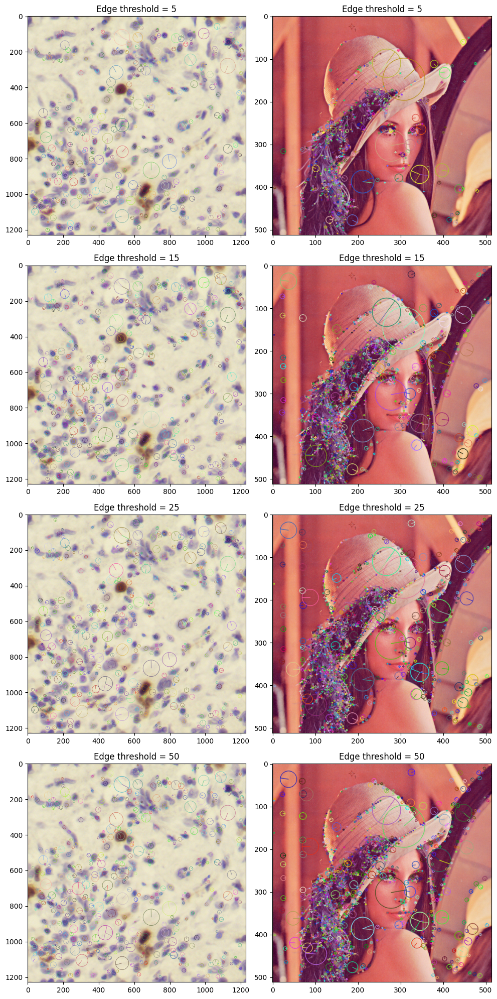

In [5]:
plt.figure(figsize=(10, 20))

for i, t in enumerate(thresholds):
    sift = cv2.SIFT_create(edgeThreshold=t)
    kp, des = sift.detectAndCompute(cells, None)
    kp2, des2 = sift.detectAndCompute(lena, None)
    
    d_cells = cv2.drawKeypoints(cells, kp, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
    d_lena = cv2.drawKeypoints(lena, kp2, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
    
    plt.subplot(4, 2, 2*i+1)
    plt.imshow(d_cells[..., ::-1])
    plt.title(f'Edge threshold = {t}')

    plt.subplot(4, 2, 2*i+2)
    plt.imshow(d_lena[..., ::-1])
    plt.title(f'Edge threshold = {t}')

plt.tight_layout()
plt.show()

#### Zadanie 2

Detektor SIFT jest w teorii niezmienniczy względem translacji, rotacji czy zmiany skali. Przetestuj te własności w praktyce, sprawdzając stabilność punktów wykrywanych na obróconej i przeskalowanej wersji obrazów `cells` i `lena`. Dokonaj oceny wizualnie, sprawdzając zachowanie detektora dla kilku wybranych rotacji i skal (**nie** grid search).

_Co świadczy o stabilności i niezmienniczości detektora?_

In [6]:
def rotate(image, angle, scale=1.0):
    center = (image.shape[0] // 2, image.shape[1] // 2)
    rmat = cv2.getRotationMatrix2D(center, angle, scale)
    return cv2.warpAffine(image, rmat, (image.shape[0], image.shape[1]), flags=cv2.INTER_CUBIC)

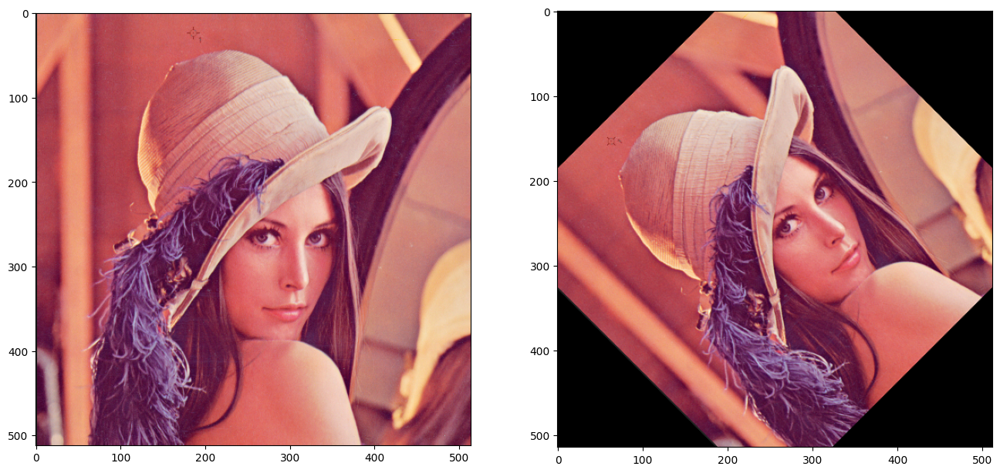

In [7]:
# przykład dla Leny, pamiętaj o cells!
lena_rot = rotate(lena, 45.0, scale=0.9)
f, (a1, a2) = plt.subplots(1, 2, figsize=(16, 10))
a1.imshow(lena[..., ::-1]);
a2.imshow(lena_rot[..., ::-1]);

In [14]:
rotations = [0, 30, 45, 90]
scales = [0.6, 0.8, 1, 1.2]
combinations = 3
sift = cv2.SIFT_create()

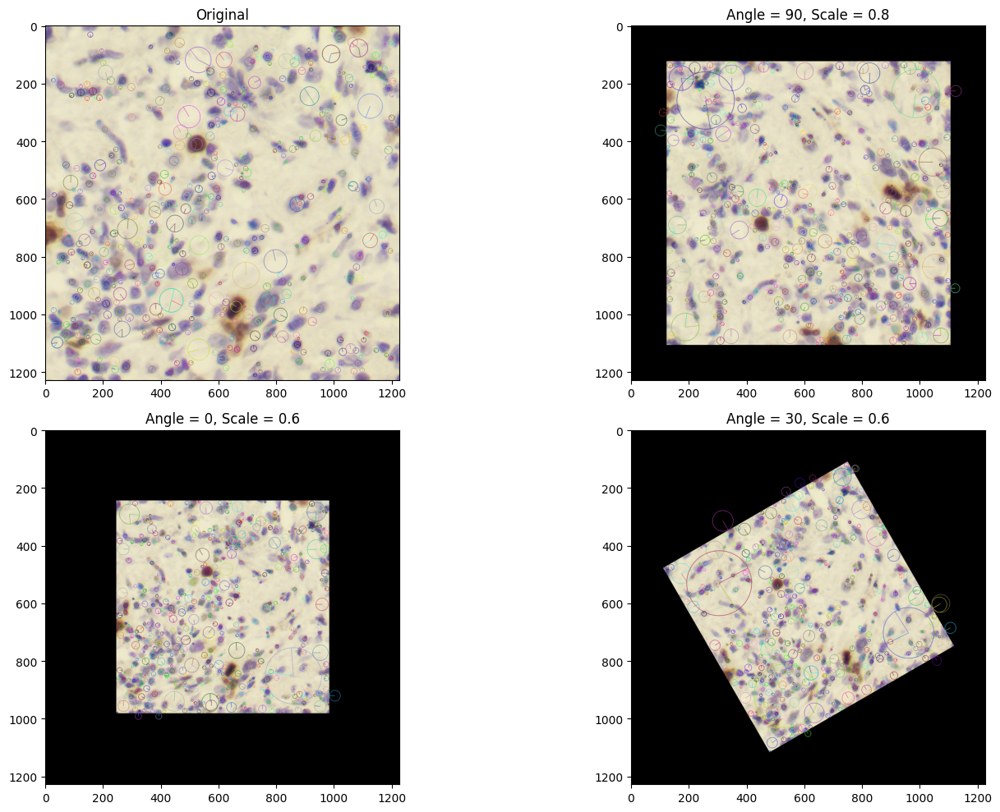

In [15]:
plt.figure(figsize=(16, 10))
plt.subplot(2,2,1)
kp, ds = sift.detectAndCompute(cells, mask=None)
d_cells = cv2.drawKeypoints(cells, kp, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
plt.imshow(d_cells[..., ::-1])
plt.title('Original')

used = []
for i in range(combinations):
    angle = np.random.choice(rotations)
    scale = np.random.choice(scales)
    while (angle, scale) in used:
        angle = np.random.choice(rotations)
        scale = np.random.choice(scales)
    used.append((angle, scale))
    
    transformed = rotate(cells, angle, scale)
    kp, ds = sift.detectAndCompute(transformed, mask=None)
    d_transformed = cv2.drawKeypoints(transformed, kp, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
    plt.subplot(2,2, i+2)
    plt.imshow(d_transformed[..., ::-1])
    plt.title(f'Angle = {angle}, Scale = {scale}')
    
plt.tight_layout()
plt.show()

Niektóre punkty kluczowe są zachowane lbu są podobne. W niektórych przypakdach jednak, wykrywane są nowe punkty kluczowe lub nie zostają odnalezione te same. Zauważalna jest największa różnica przy znacznym zmniejszeniu obrazu. Przy skalowaniu 0.6 ciężko odnależć odpowaidające sobie PK.

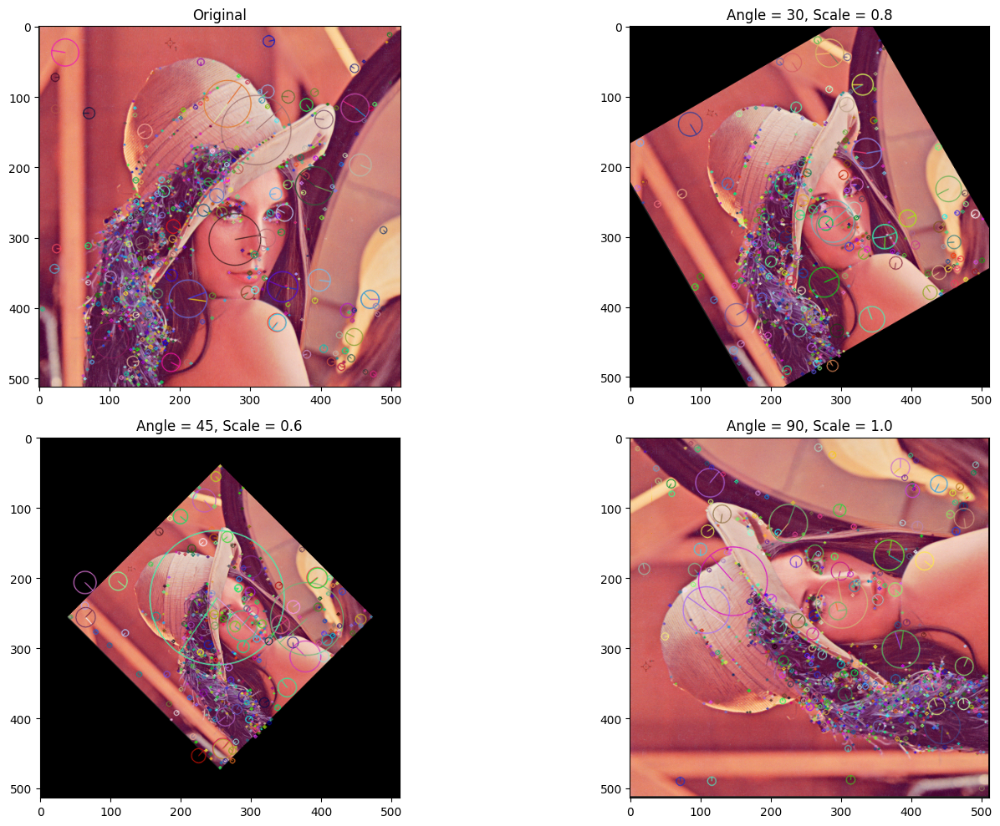

In [16]:
plt.figure(figsize=(16, 10))
plt.subplot(2,2,1)
kp, ds = sift.detectAndCompute(lena, mask=None)
d_lena = cv2.drawKeypoints(lena, kp, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
plt.imshow(d_lena[..., ::-1])
plt.title('Original')

used = []
for i in range(combinations):
    angle = np.random.choice(rotations)
    scale = np.random.choice(scales)
    while (angle, scale) in used:
        angle = np.random.choice(rotations)
        scale = np.random.choice(scales)
    used.append((angle, scale))
    
    transformed = rotate(lena, angle, scale)
    kp, ds = sift.detectAndCompute(transformed, mask=None)
    d_transformed = cv2.drawKeypoints(transformed, kp, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
    plt.subplot(2,2, i+2)
    plt.imshow(d_transformed[..., ::-1])
    plt.title(f'Angle = {angle}, Scale = {scale}')
    
plt.tight_layout()
plt.show()

#### Zadanie 3

Dane są obrazy `coke` i `table`. Wykorzystaj metodologię parowania punktów kluczowych do znalezienia wystąpienia puszki z Colą na stole. To zadanie jest podzielone na dwie części - czytaj dalej.

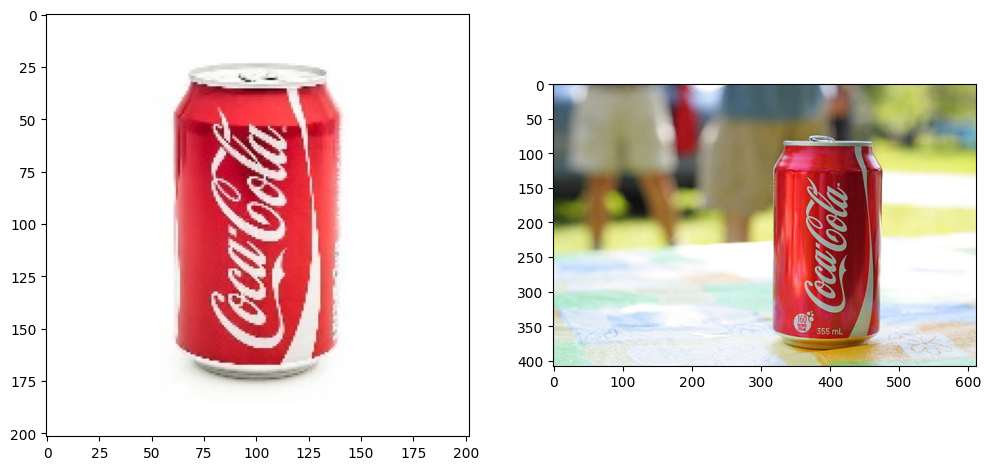

In [133]:
coke = cv2.imread('coke.jpg')
table = cv2.imread('coke-table.jpg')
f, (a1, a2) = plt.subplots(1, 2, figsize=(12,12))
a1.imshow(coke[..., ::-1]);
a2.imshow(table[..., ::-1]);

##### Zadanie 3a

Wykonaj detekcję punktów kluczowych i ich parowanie z użyciem dowolnego matchera. Wykonaj filtrację znalezionych par po dystansie - co obserwujesz, zmieniając próg?

In [134]:
def find_kp(image1, image2, ct, et):
    sift = cv2.SIFT_create(contrastThreshold=ct, edgeThreshold=et)
    kp1, des1 = sift.detectAndCompute(image1, mask=None)
    kp2, des2 = sift.detectAndCompute(image2, mask=None)
    plt.figure(figsize=(16, 10))
    plt.subplot(1,2,1)
    d1 = cv2.drawKeypoints(image1, kp1, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
    plt.imshow(d1[..., ::-1])
    plt.subplot(1,2,2)
    d2 = cv2.drawKeypoints(image2, kp2, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
    plt.imshow(d2[..., ::-1])
    return kp1, des1, kp2, des2

In [135]:
def show_matches(kp1, ds1, kp2, ds2, image1, image2, distance_threshold):
    matcher = cv2.BFMatcher_create()
    best_matches = matcher.match(ds1, ds2)
    good_matches = [m for m in best_matches if m.distance < distance_threshold]
    distances = [m.distance for m in best_matches]
    print(f'Min distance: {min(distances)}, Max distance: {max(distances)}')
    show_matches = cv2.drawMatches(image1, kp1, image2, kp2, good_matches, None, matchColor=(0,255,0), singlePointColor=(0,0,255))
    plt.subplots(1, 1, figsize=(12,12))[1].imshow(show_matches[...,::-1]);
    plt.show()
    return good_matches

Min distance: 65.85590362548828, Max distance: 453.7234802246094


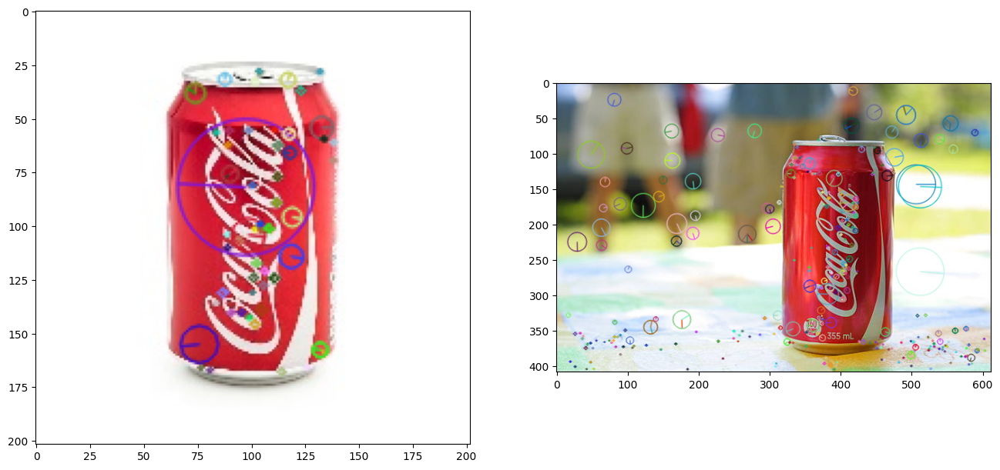

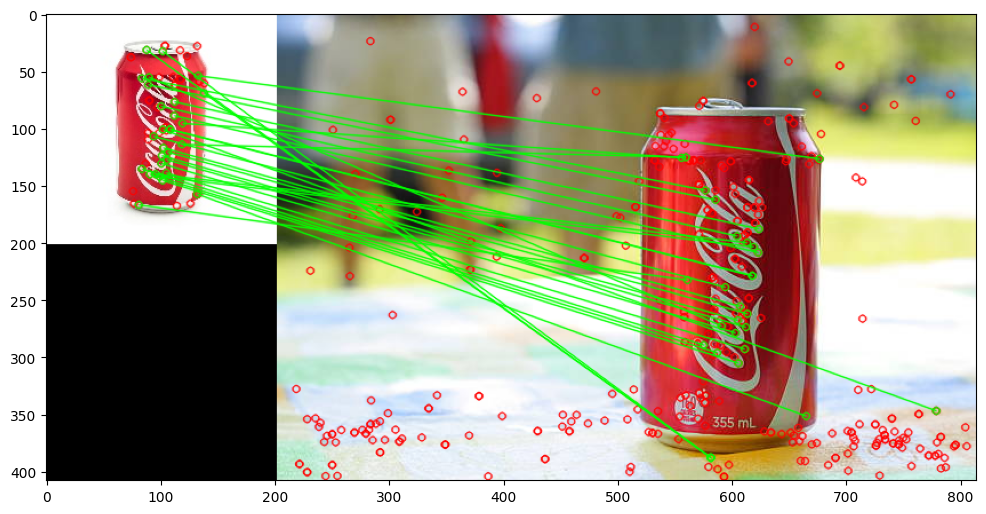

In [136]:
kp1, ds1, kp2, ds2 = find_kp(coke, table, 0.02, 5)
x = show_matches(kp1, ds1, kp2, ds2, coke, table, 300)

Min distance: 65.85590362548828, Max distance: 455.6819152832031


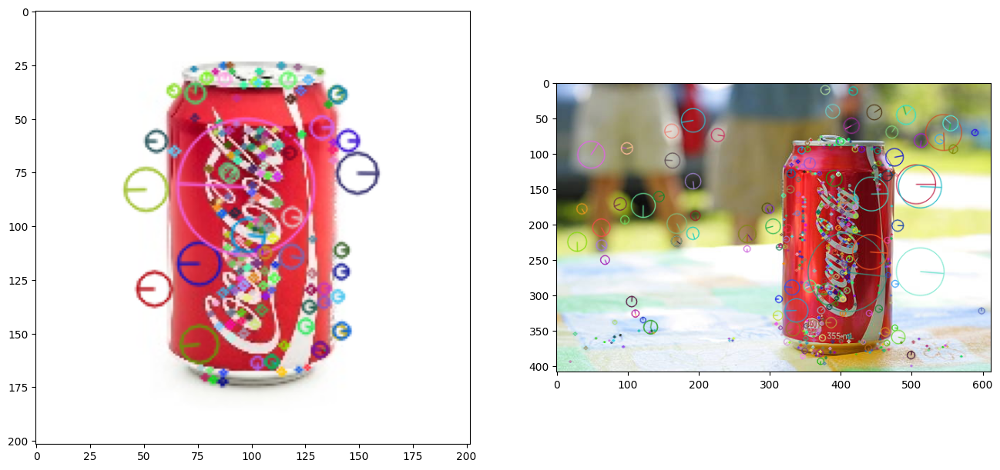

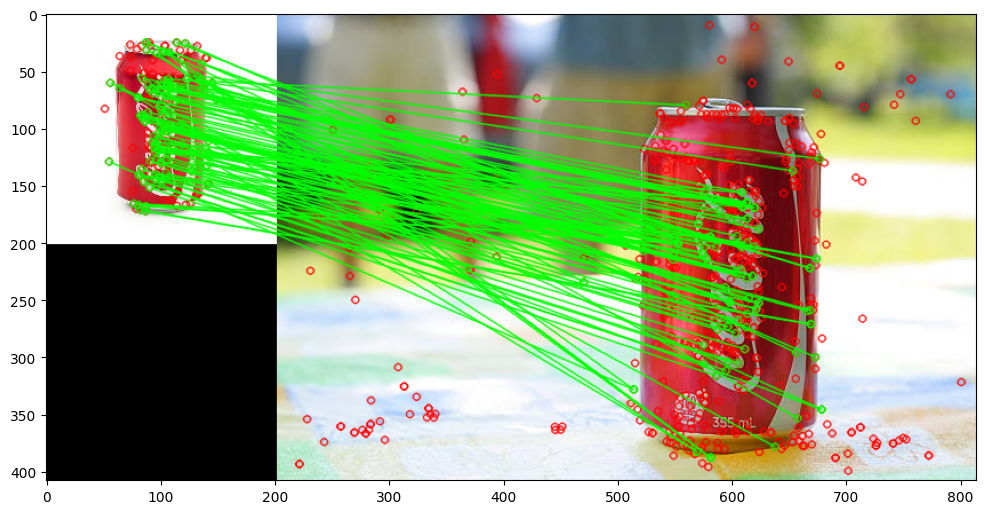

In [137]:
kp1, ds1, kp2, ds2 = find_kp(coke, table, 0.03, 50)
x = show_matches(kp1, ds1, kp2, ds2, coke, table, 250)

Min distance: 65.85590362548828, Max distance: 455.6819152832031


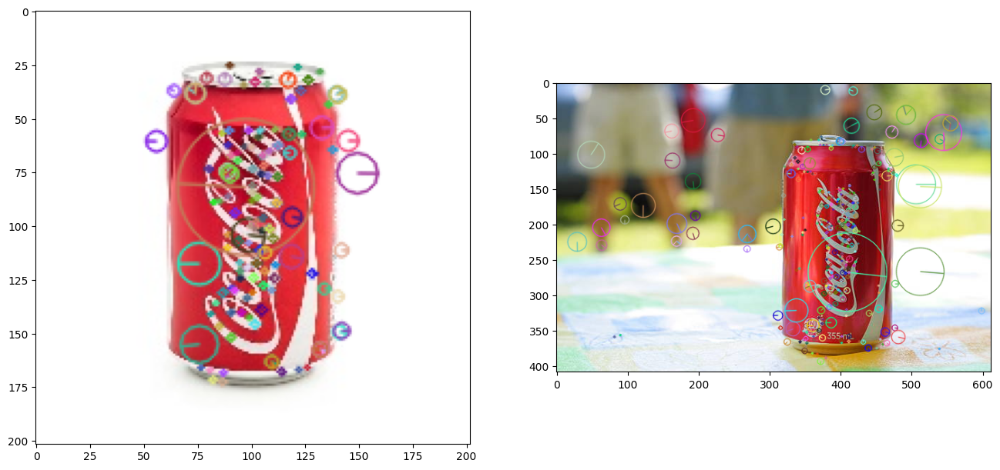

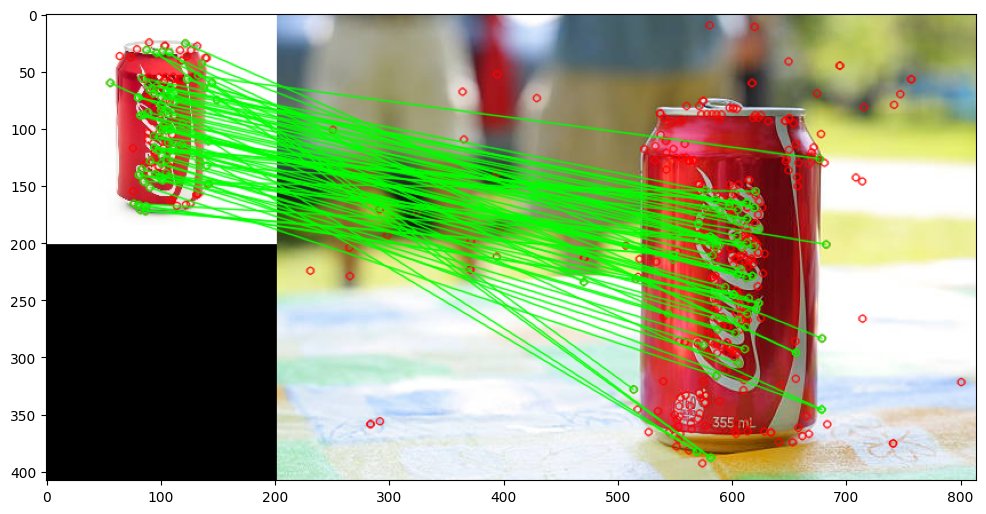

In [138]:
kp1, ds1, kp2, ds2 = find_kp(coke, table, 0.05, 20)
x = show_matches(kp1, ds1, kp2, ds2, coke, table, 250)

##### Zadanie 3b

Znajdź transformację geometryczną dla par dopasowanych punktów, tak aby przekształcić `coke` (_train_) do geometrii `table` (_query_). Zademonstruj poprawność, zestawiając obok siebie przekształconą wersję `coke` oraz oryginalny `table`, bądź nanosząc jedno na drugie. Zidentyfikuj punkty, które znaleziona transformacja przekształca "dobrze", tzn. ich współrzędne po przekształceniu leżą w pobliżu odpowiadających im punktów z drugiego obrazu; nanieś je na obraz.

*Jak na wyniki wpływa wykrycie większej lub mniejszej liczby punktów kluczowych na etapie SIFT? W jakim stopniu filtracja poprawia rezultaty? Jak działa i jaką rolę w procesie parowania odgrywa RANSAC?*

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def find_homography_and_transform(kp1, kp2, matches, image1, image2, reproj_thresh=3.0):
    
    src_pts = np.float32([kp1[m.queryIdx].pt for m in matches]).reshape(-1, 1, 2)
    dst_pts = np.float32([kp2[m.trainIdx].pt for m in matches]).reshape(-1, 1, 2)

    H, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, reproj_thresh)
    matches_mask = mask.ravel().tolist()

    height, width = image2.shape[:2]
    transformed_image = cv2.warpPerspective(image1, H, (width, height))

    good_points = [i for i, m in enumerate(matches_mask) if m == 1]
    transformed_pts = cv2.perspectiveTransform(src_pts, H)
    transformed_pts = transformed_pts[good_points]

    image2_copy = image2.copy()
    image1_copy = image1.copy()
    for pt in transformed_pts:
        cv2.circle(image2_copy, (int(pt[0][0]), int(pt[0][1])), 3, (0, 255, 0), -1)
    for pt in src_pts[good_points]:
        cv2.circle(image1_copy, (int(pt[0][0]), int(pt[0][1])), 3, (0, 255, 0), -1)
    plt.figure(figsize=(16, 10))
    plt.subplot(1, 3, 1)
    plt.title("Obraz oryginalny (coke)")
    plt.imshow(image1_copy[..., ::-1])
    plt.subplot(1, 3, 2)
    plt.title("Przekształcony obraz (coke)")
    plt.imshow(transformed_image[..., ::-1])
    plt.subplot(1, 3, 3)
    plt.title("Obraz docelowy (table)")
    plt.imshow(image2_copy[..., ::-1])
    plt.show()

    return H, transformed_image, matches_mask


Min distance: 65.85590362548828, Max distance: 455.6819152832031


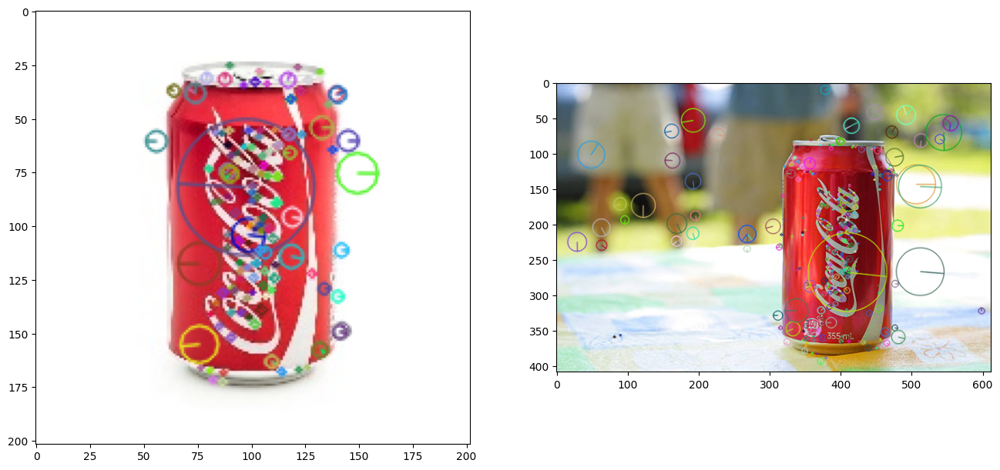

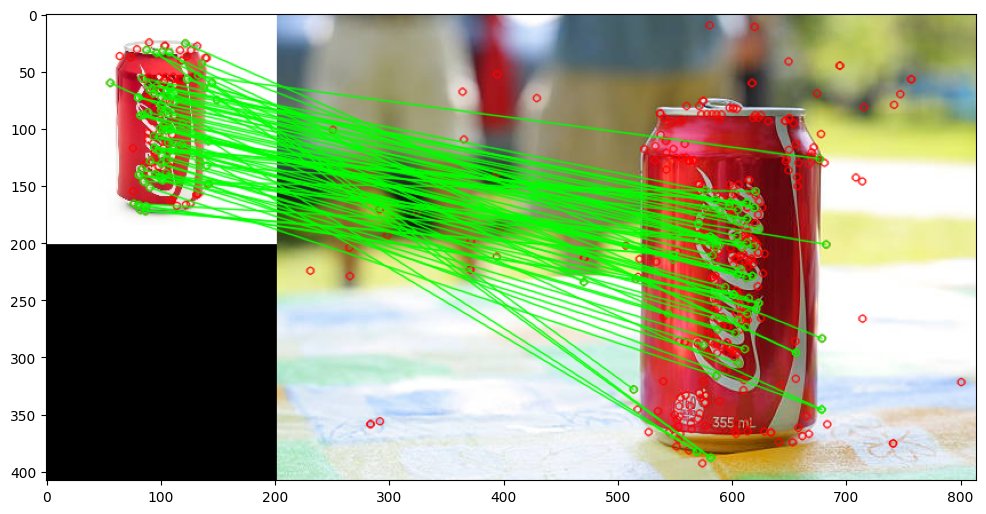

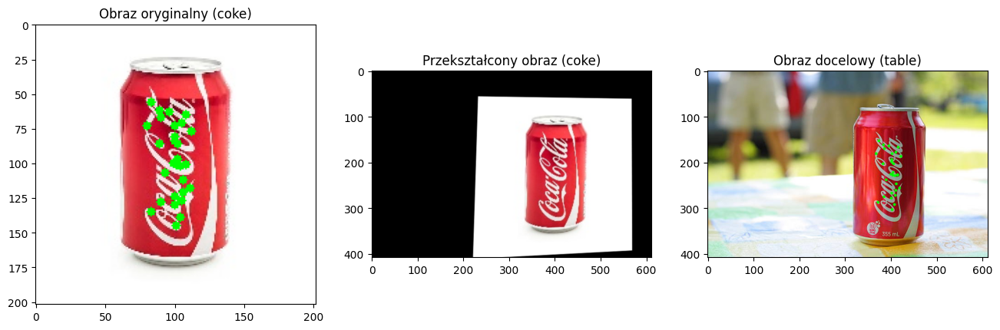

In [155]:
coke = cv2.imread('coke.jpg')
table = cv2.imread('coke-table.jpg')
kp1, ds1, kp2, ds2 = find_kp(coke, table, 0.05, 20)
good_matches = show_matches(kp1, ds1, kp2, ds2, coke, table, 250)
H, transformed_image, matches_mask = find_homography_and_transform(kp1, kp2, good_matches, coke, table)

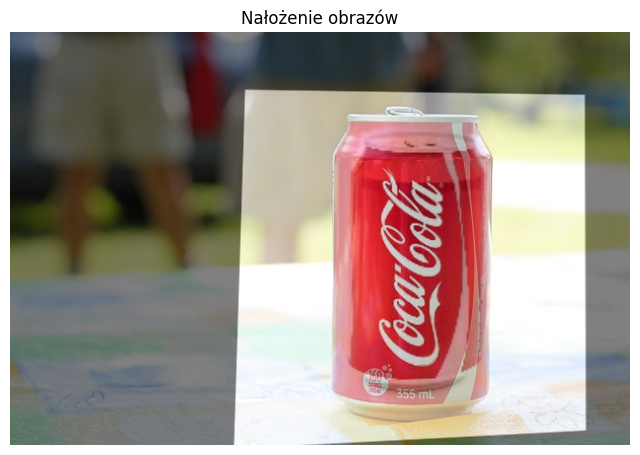

In [157]:
def overlay_images(image1, image2, alpha=0.5):
    if image1.shape[:2] != image2.shape[:2]:
        image1 = cv2.resize(image1, (image2.shape[1], image2.shape[0]))
    
    blended = cv2.addWeighted(image1, alpha, image2, 1 - alpha, 0)

    plt.figure(figsize=(8, 8))
    plt.title("Nałożenie obrazów")
    plt.imshow(blended[..., ::-1])
    plt.axis('off')
    plt.show()

overlay_images(transformed_image, table, alpha=0.5)

### Inne parametry

Min distance: 65.85590362548828, Max distance: 453.7234802246094


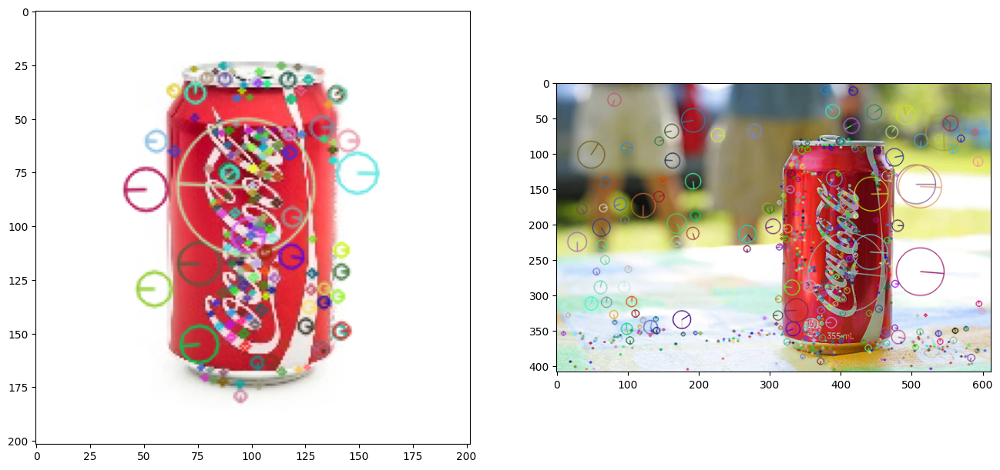

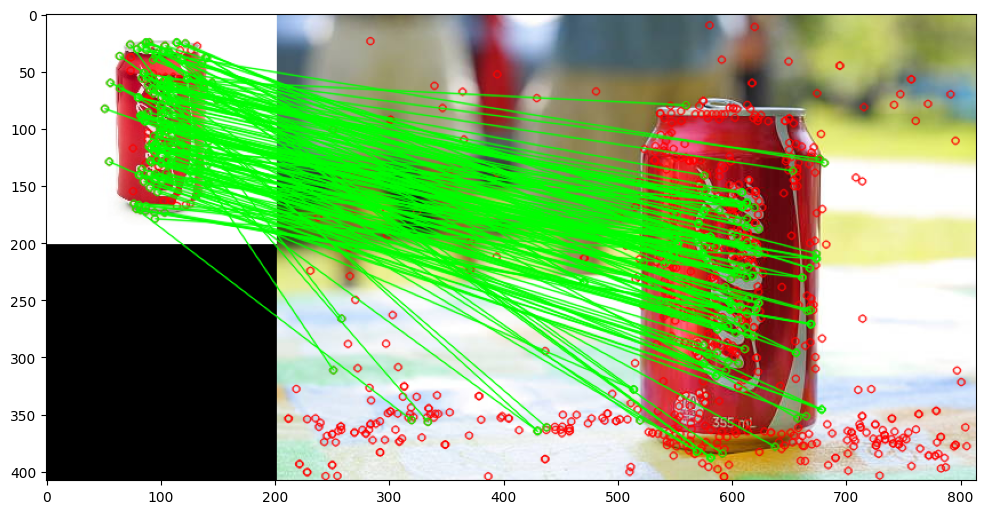

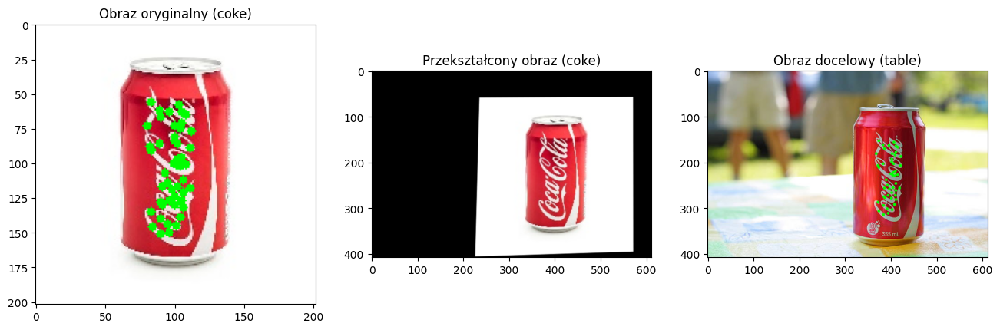

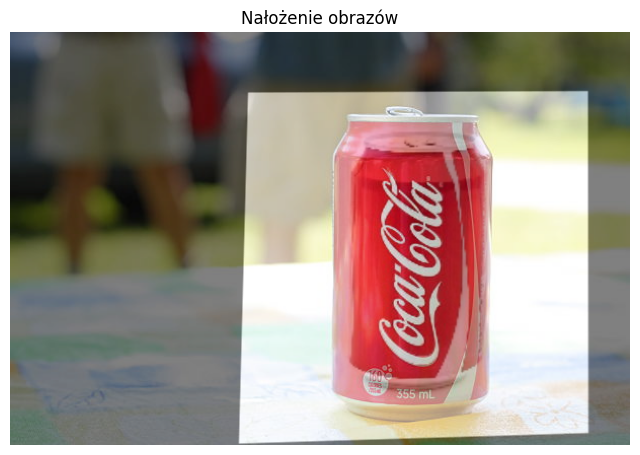

In [166]:
coke = cv2.imread('coke.jpg')
table = cv2.imread('coke-table.jpg')
kp1, ds1, kp2, ds2 = find_kp(coke, table, 0.02, 100)
good_matches = show_matches(kp1, ds1, kp2, ds2, coke, table, 300)
H, transformed_image, matches_mask = find_homography_and_transform(kp1, kp2, good_matches, coke, table)
overlay_images(transformed_image, table, alpha=0.5)

Min distance: 65.85590362548828, Max distance: 455.6819152832031


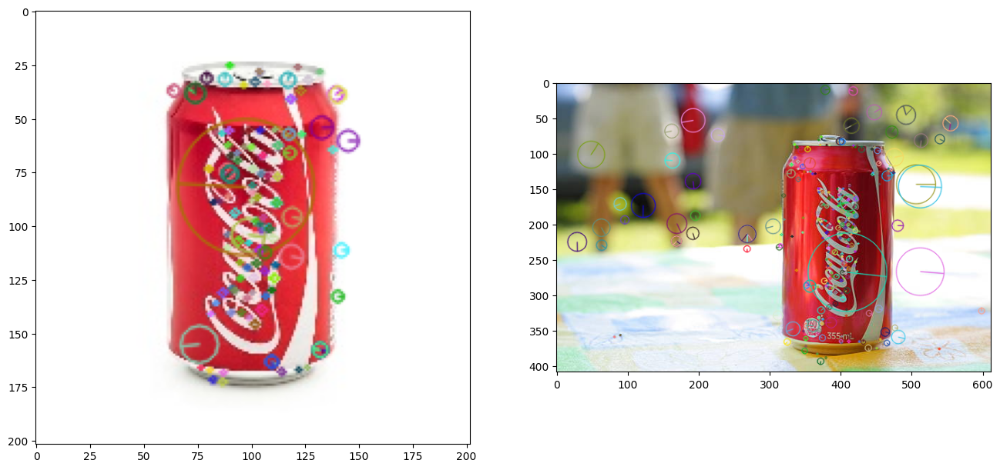

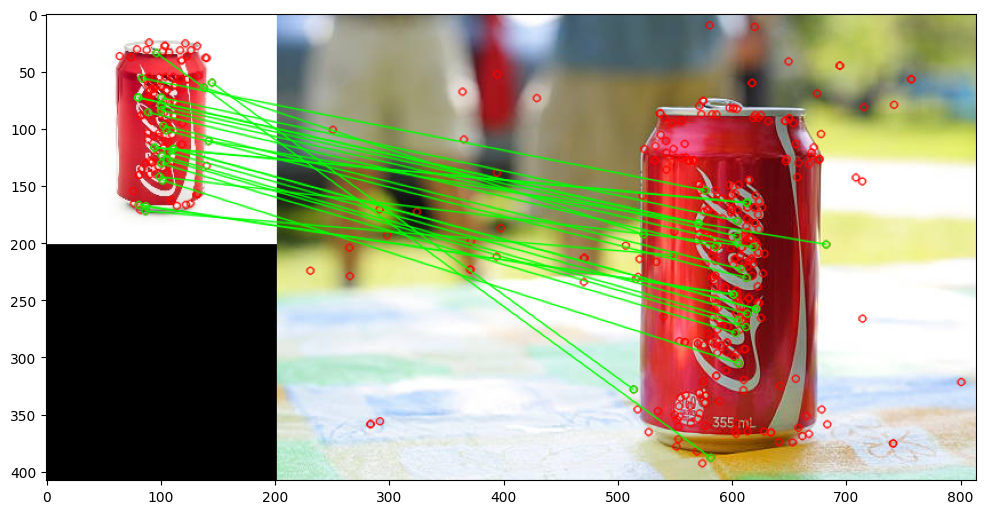

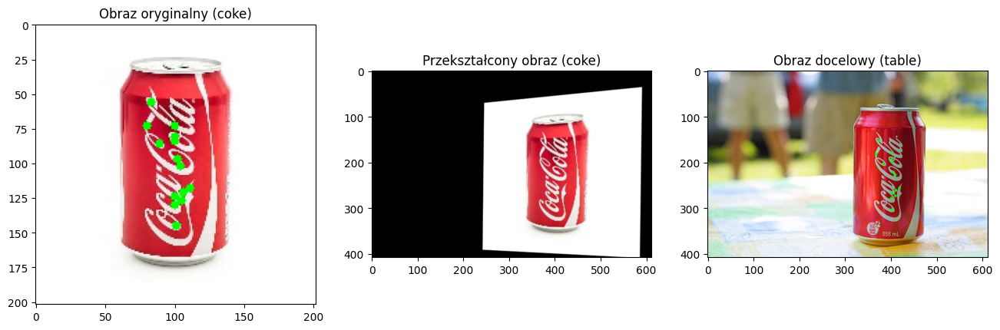

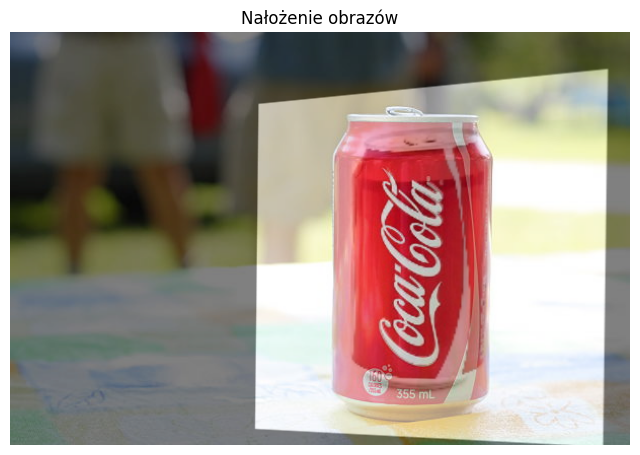

In [164]:
coke = cv2.imread('coke.jpg')
table = cv2.imread('coke-table.jpg')
kp1, ds1, kp2, ds2 = find_kp(coke, table, 0.05, 15)
good_matches = show_matches(kp1, ds1, kp2, ds2, coke, table, 200)
H, transformed_image, matches_mask = find_homography_and_transform(kp1, kp2, good_matches, coke, table)
overlay_images(transformed_image, table, alpha=0.5)